# Upgrading Scikit Learn Library

In [1]:
!pip install scikit-learn==1.5.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.3/13.3 MB 20.3 MB/s eta 0:00:00
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2


# Importing Dependencies & Dataset

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

Data collection

In [4]:
#loading the data
wine_quality_data = pd.read_csv('/content/ML-Project 6 winequality-red.csv')

# Exploratory Data Analysis

In [5]:
# first 5 rows in the dataset
wine_quality_data.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
0,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5
1,7.8,0.88,0.00,2.6,0.098,25.0,67.0,0.9968,3.20,0.68,9.8,5
2,7.8,0.76,0.04,2.3,0.092,15.0,54.0,0.9970,3.26,0.65,9.8,5
3,11.2,0.28,0.56,1.9,0.075,17.0,60.0,0.9980,3.16,0.58,9.8,6
4,7.4,0.70,0.00,1.9,0.076,11.0,34.0,0.9978,3.51,0.56,9.4,5


In [6]:
# last 5 rows in the dataset
wine_quality_data.tail()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
1594,6.2,0.600,0.08,2.0,0.090,32.0,44.0,0.99490,3.45,0.58,10.5,5
1595,5.9,0.550,0.10,2.2,0.062,39.0,51.0,0.99512,3.52,0.76,11.2,6
1596,6.3,0.510,0.13,2.3,0.076,29.0,40.0,0.99574,3.42,0.75,11.0,6
1597,5.9,0.645,0.12,2.0,0.075,32.0,44.0,0.99547,3.57,0.71,10.2,5
1598,6.0,0.310,0.47,3.6,0.067,18.0,42.0,0.99549,3.39,0.66,11.0,6


In [7]:
# number of rows & columns
wine_quality_data.shape

(1599, 12)

In [8]:
# getting info about the dataset
wine_quality_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599 entries, 0 to 1598
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   fixed acidity         1599 non-null   float64
 1   volatile acidity      1599 non-null   float64
 2   citric acid           1599 non-null   float64
 3   residual sugar        1599 non-null   float64
 4   chlorides             1599 non-null   float64
 5   free sulfur dioxide   1599 non-null   float64
 6   total sulfur dioxide  1599 non-null   float64
 7   density               1599 non-null   float64
 8   pH                    1599 non-null   float64
 9   sulphates             1599 non-null   float64
 10  alcohol               1599 non-null   float64
 11  quality               1599 non-null   int64  
dtypes: float64(11), int64(1)
memory usage: 150.0 KB


In [9]:
# checking null values
wine_quality_data.isnull().sum()

fixed acidity           0
volatile acidity        0
citric acid             0
residual sugar          0
chlorides               0
free sulfur dioxide     0
total sulfur dioxide    0
density                 0
pH                      0
sulphates               0
alcohol                 0
quality                 0
dtype: int64

In [10]:
# getting the stats about dataset
wine_quality_data.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol,quality
count,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000,1599.000000
mean,8.319637,0.527821,0.270976,2.538806,0.087467,15.874922,46.467792,0.996747,3.311113,0.658149,10.422983,5.636023
std,1.741096,0.179060,0.194801,1.409928,0.047065,10.460157,32.895324,0.001887,0.154386,0.169507,1.065668,0.807569
min,4.600000,0.120000,0.000000,0.900000,0.012000,1.000000,6.000000,0.990070,2.740000,0.330000,8.400000,3.000000
25%,7.100000,0.390000,0.090000,1.900000,0.070000,7.000000,22.000000,0.995600,3.210000,0.550000,9.500000,5.000000
50%,7.900000,0.520000,0.260000,2.200000,0.079000,14.000000,38.000000,0.996750,3.310000,0.620000,10.200000,6.000000
75%,9.200000,0.640000,0.420000,2.600000,0.090000,21.000000,62.000000,0.997835,3.400000,0.730000,11.100000,6.000000
max,15.900000,1.580000,1.000000,15.500000,0.611000,72.000000,289.000000,1.003690,4.010000,2.000000,14.900000,8.000000


In [11]:
#number of labels
wine_quality_data['quality'].value_counts()

quality
5    681
6    638
7    199
4     53
8     18
3     10
Name: count, dtype: int64

In [12]:
# stastical data according to labels
wine_quality_data.groupby('quality').mean()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
quality,,,,,,,,,,,
3,8.360000,0.884500,0.171000,2.635000,0.122500,11.000000,24.900000,0.997464,3.398000,0.570000,9.955000
4,7.779245,0.693962,0.174151,2.694340,0.090679,12.264151,36.245283,0.996542,3.381509,0.596415,10.265094
5,8.167254,0.577041,0.243686,2.528855,0.092736,16.983847,56.513950,0.997104,3.304949,0.620969,9.899706
6,8.347179,0.497484,0.273824,2.477194,0.084956,15.711599,40.869906,0.996615,3.318072,0.675329,10.629519
7,8.872362,0.403920,0.375176,2.720603,0.076588,14.045226,35.020101,0.996104,3.290754,0.741256,11.465913
8,8.566667,0.423333,0.391111,2.577778,0.068444,13.277778,33.444444,0.995212,3.267222,0.767778,12.094444


In [13]:
#setting the parameters
plt.rcParams['figure.figsize'] = [8,8]
plt.rcParams['figure.dpi'] = 100

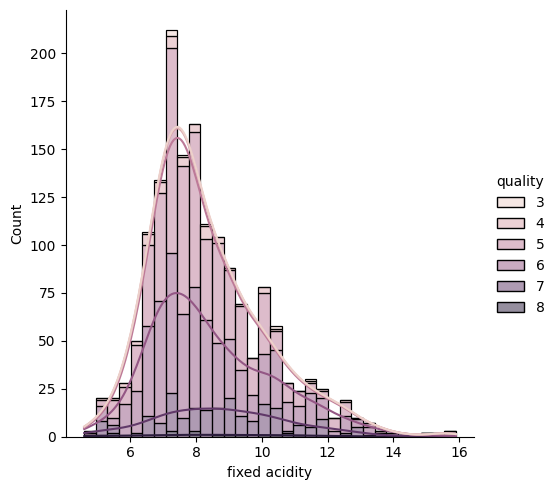

In [14]:
# distribution plot for fixed acidity
sns.displot(data=wine_quality_data, x = 'fixed acidity', kde=True,
           hue='quality', multiple='stack')

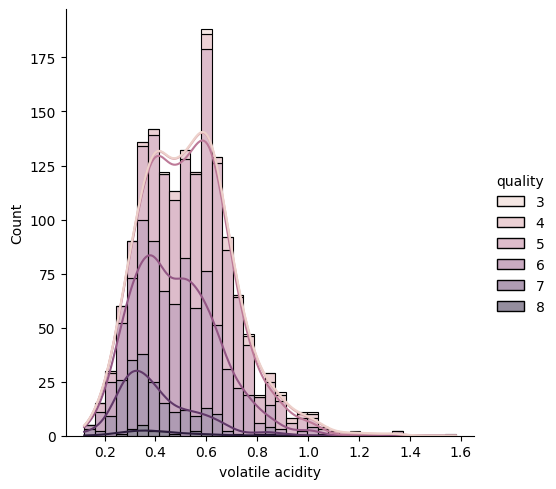

In [15]:
# distribution plot for volatile acidity
sns.displot(data=wine_quality_data, x = 'volatile acidity', kde=True,
           hue='quality', multiple='stack')

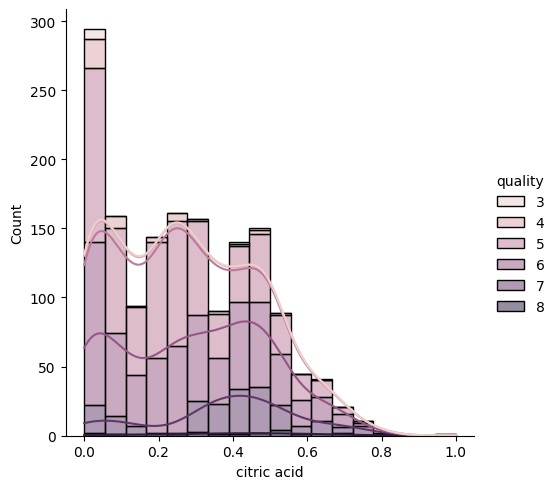

In [16]:
# distribution plot for citric acid
sns.displot(data=wine_quality_data, x = 'citric acid', kde=True,
           hue='quality', multiple='stack')

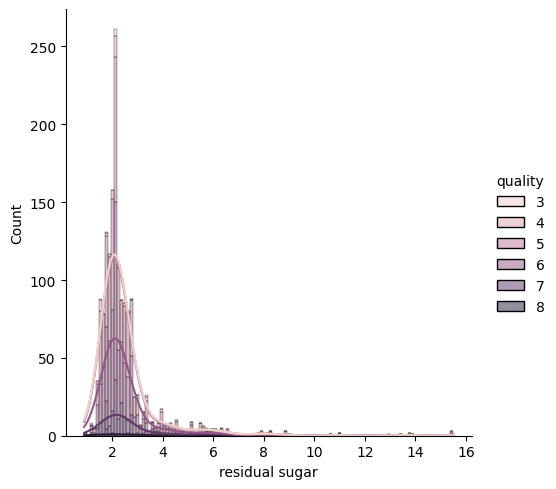

In [17]:
# distribution plot for residual sugar
sns.displot(data=wine_quality_data, x = 'residual sugar', kde=True,
           hue='quality', multiple='stack')

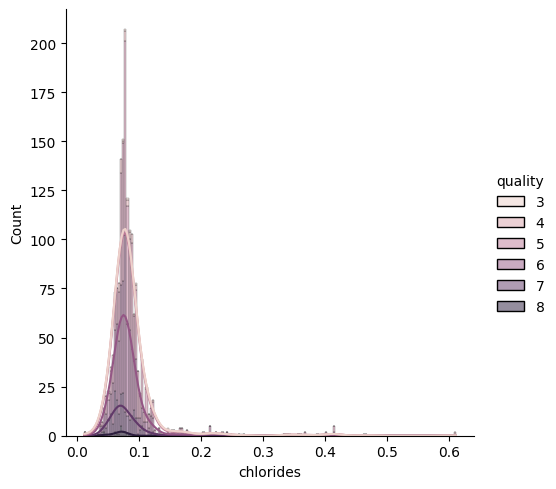

In [18]:
# distribution plot for chlorides
sns.displot(data=wine_quality_data, x = 'chlorides', kde=True,
           hue='quality', multiple='stack')

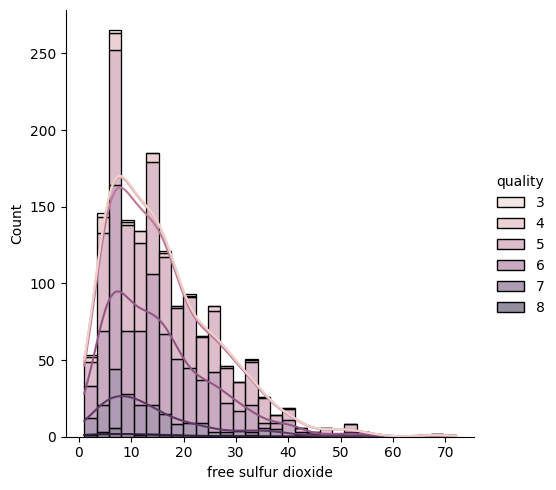

In [19]:
# distribution plot for free sulfur dioxide
sns.displot(data=wine_quality_data, x = 'free sulfur dioxide', kde=True,
           hue='quality', multiple='stack')

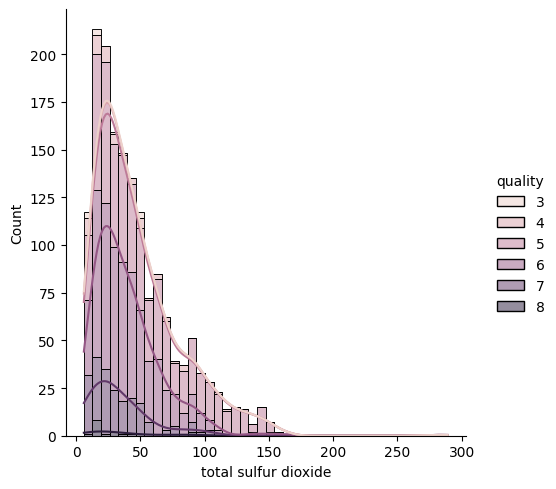

In [20]:
# distribution plot for total sulfur dioxide
sns.displot(data=wine_quality_data, x = 'total sulfur dioxide', kde=True,
           hue='quality', multiple='stack')

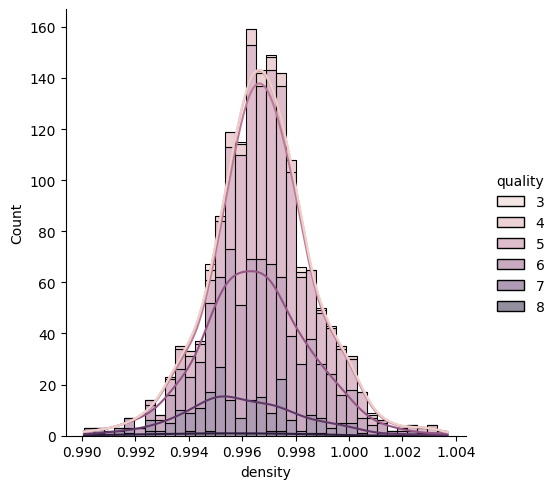

In [21]:
# distribution plot for density
sns.displot(data=wine_quality_data, x = 'density', kde=True,
           hue='quality', multiple='stack')

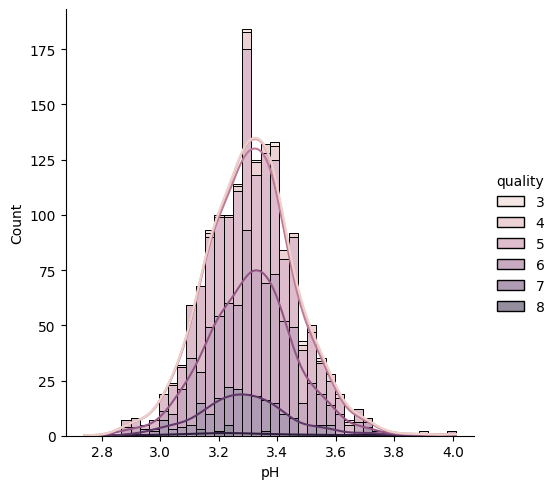

In [22]:
# distribution plot for pH
sns.displot(data=wine_quality_data, x = 'pH', kde=True,
           hue='quality', multiple='stack')

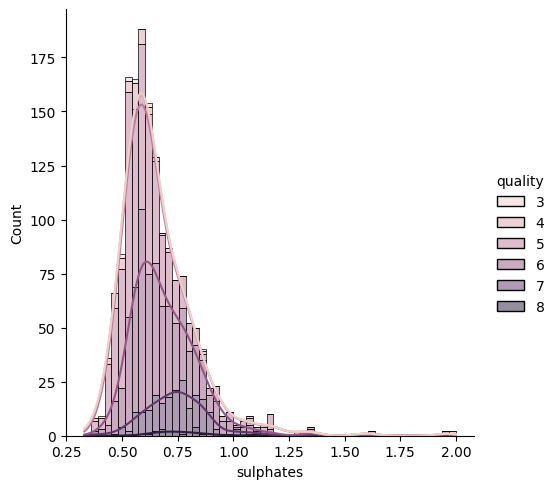

In [23]:
# distribution plot for sulphates
sns.displot(data=wine_quality_data, x = 'sulphates', kde=True,
           hue='quality', multiple='stack')

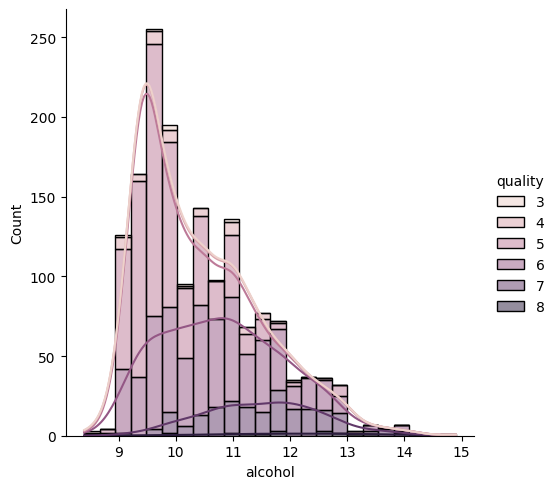

In [24]:
# distribution plot for alcohol
sns.displot(data=wine_quality_data, x = 'alcohol', kde=True,
           hue='quality', multiple='stack')

In [25]:
#setting the parameters
plt.rcParams['figure.figsize'] = [20,10]
plt.rcParams['figure.dpi'] = 300

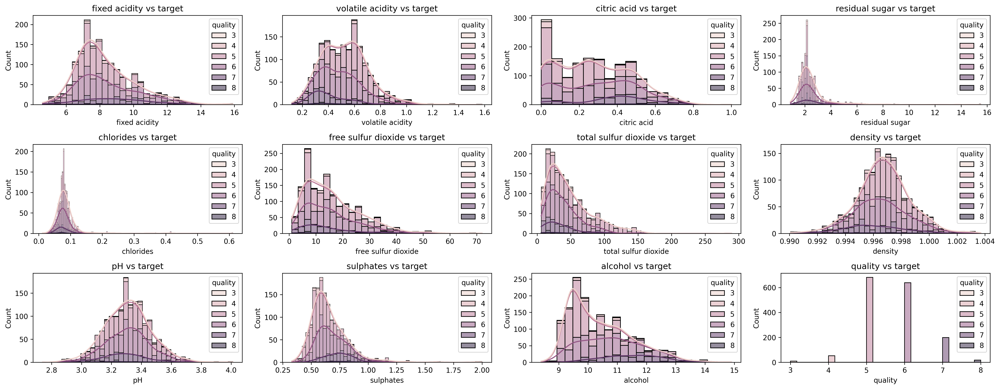

In [26]:
# subplot for all the columns
columns = wine_quality_data.columns
for i, col in enumerate(columns):
    plt.subplot(4,4, i+1)
    sns.histplot(x=col, data=wine_quality_data, hue='quality', multiple='stack', kde=True)
    plt.xlabel(col)
    plt.title("{} vs target".format(col))
    plt.tight_layout()

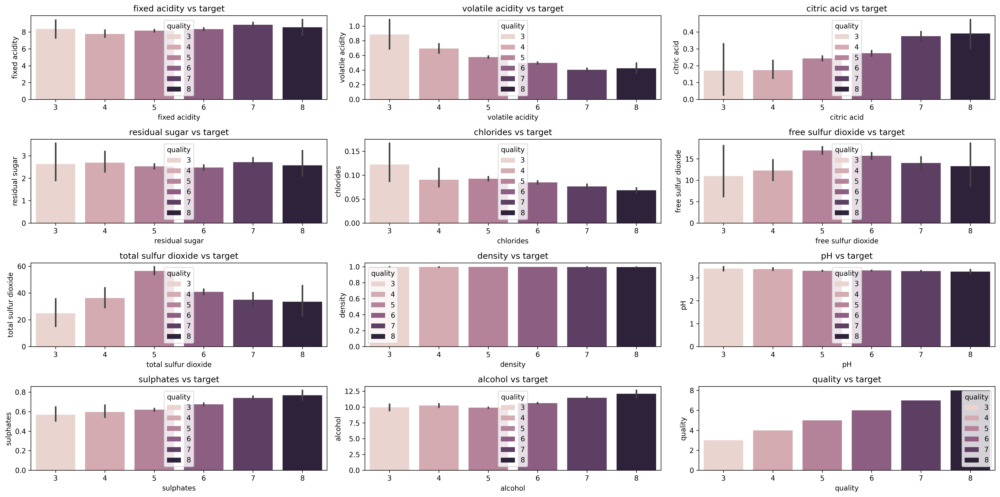

In [27]:
# bar subplot for all the columns
columns = wine_quality_data.columns
for i, col in enumerate(columns):
    plt.subplot(4,3, i+1)
    sns.barplot(x='quality', y=col, data = wine_quality_data, hue='quality')
    plt.xlabel(col)
    plt.title("{} vs target".format(col))
    plt.tight_layout()

In [28]:
#pairplot for the dataset
sns.pairplot(wine_quality_data, hue='quality')

<Axes: >

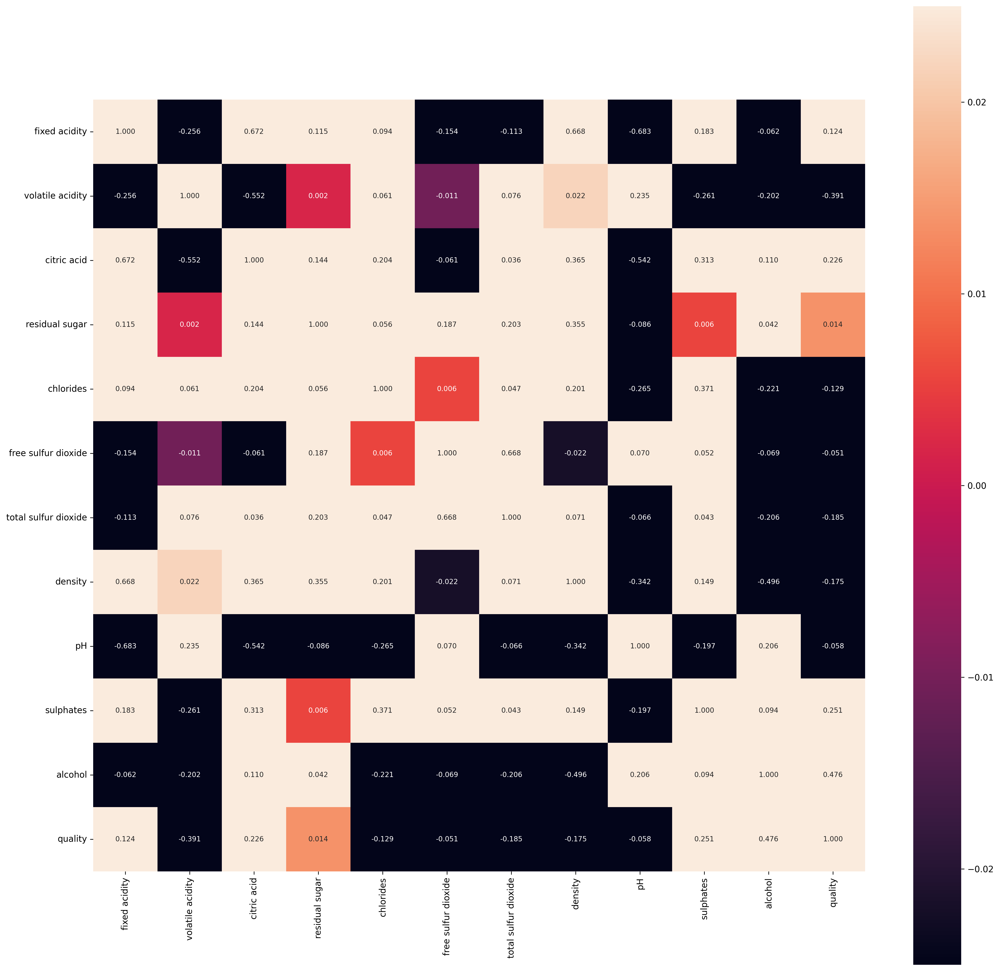

In [29]:
# constructing a heat map to understand correlation
correlation = wine_quality_data.corr()
plt.figure(figsize=(20,20))
sns.heatmap(correlation, vmin=-0.025 , vmax=0.025,cbar=True,square=True,annot=True,fmt='.3f', annot_kws={'size':8})

# Data Preprocessing & Splitting

Replacing the outliers with mean values

In [30]:
# checking the numnber of outliers in fixed acidity
wine_quality_data[wine_quality_data['fixed acidity']>14].shape

(8, 12)

In [31]:
#taking avg for outliers
avg_fixed_acidity = wine_quality_data.loc[wine_quality_data['fixed acidity'] <= 14, 'fixed acidity'].mean()

In [32]:
print(avg_fixed_acidity)

8.284538026398492


In [33]:
#replaceing the outliers by mean
wine_quality_data.loc[wine_quality_data['fixed acidity'] > 14, 'fixed acidity'] = avg_fixed_acidity

In [34]:
# checking the numnber of outliers in fixed acidity
wine_quality_data[wine_quality_data['fixed acidity']>14].shape

(0, 12)

In [35]:
# checking the numnber of outliers in fixed acidity
wine_quality_data[wine_quality_data['volatile acidity']>1.1].shape

(8, 12)

In [36]:
#taking avg for outliers
avg_volatile_acidity = wine_quality_data.loc[wine_quality_data['volatile acidity'] <= 1.1, 'volatile acidity'].mean()
print(avg_volatile_acidity)

#replaceing the outliers by mean
wine_quality_data.loc[wine_quality_data['volatile acidity'] > 1.1, 'volatile acidity'] = avg_volatile_acidity

# checking the numnber of outliers in volatile acidity
wine_quality_data[wine_quality_data['volatile acidity']>1.1].shape

0.5241326209930861


(0, 12)

In [37]:
# checking the numnber of outliers in citric acid
wine_quality_data[wine_quality_data['citric acid']>0.8].shape

(1, 12)

In [38]:
# checking the numnber of outliers in residual sugar
wine_quality_data[wine_quality_data['residual sugar']>7].shape

(29, 12)

In [39]:
#taking avg for outliers
avg_residual_sugar = wine_quality_data.loc[wine_quality_data['residual sugar'] <= 7, 'residual sugar'].mean()
print(avg_residual_sugar)

#replaceing the outliers by mean
wine_quality_data.loc[wine_quality_data['residual sugar'] > 7, 'residual sugar'] = avg_residual_sugar

# checking the numnber of outliers in residual sugar
wine_quality_data[wine_quality_data['residual sugar']>7].shape

2.3988853503184715


(0, 12)

In [40]:
# checking the numnber of outliers in chlorides
wine_quality_data[wine_quality_data['chlorides']>0.3].shape

(22, 12)

In [41]:
#taking avg for outliers
avg_chlorides = wine_quality_data.loc[wine_quality_data['chlorides'] <= 0.3, 'chlorides'].mean()
print(avg_chlorides)

#replaceing the outliers by mean
wine_quality_data.loc[wine_quality_data['chlorides'] > 0.3, 'chlorides'] = avg_chlorides

# checking the numnber of outliers in residual sugar
wine_quality_data[wine_quality_data['chlorides']>0.3].shape

0.08294229549778058


(0, 12)

In [42]:
# checking the numnber of outliers in free sulfur dioxide
wine_quality_data[wine_quality_data['free sulfur dioxide']>55].shape

(5, 12)

In [43]:
#taking avg for outliers
avg_free_sulfur_dioxide = wine_quality_data.loc[wine_quality_data['free sulfur dioxide'] <= 55, 'free sulfur dioxide'].mean()
print(avg_free_sulfur_dioxide)

#replaceing the outliers by mean
wine_quality_data.loc[wine_quality_data['free sulfur dioxide'] > 55, 'free sulfur dioxide'] = avg_free_sulfur_dioxide

# checking the numnber of outliers in free sulfur dioxide
wine_quality_data[wine_quality_data['free sulfur dioxide']>55].shape

15.717063989962359


(0, 12)

In [44]:
# checking the numnber of outliers in total sulfur dioxide
wine_quality_data[wine_quality_data['total sulfur dioxide']>160].shape

(3, 12)

In [45]:
#taking avg for outliers
avg_total_sulfur_dioxide = wine_quality_data.loc[wine_quality_data['total sulfur dioxide'] <= 160, 'total sulfur dioxide'].mean()
print(avg_total_sulfur_dioxide)

#replaceing the outliers by mean
wine_quality_data.loc[wine_quality_data['total sulfur dioxide'] > 160, 'total sulfur dioxide'] = avg_total_sulfur_dioxide

# checking the numnber of outliers in total sulfur dioxide
wine_quality_data[wine_quality_data['total sulfur dioxide']>160].shape

46.09649122807018


(0, 12)

In [46]:
# checking the numnber of outliers in pH
wine_quality_data[(wine_quality_data['pH']<2.8)|(wine_quality_data['pH']>3.8)].shape

(6, 12)

In [47]:
#taking avg for outliers
avg_pH = wine_quality_data.loc[(wine_quality_data['pH']>=2.8)&(wine_quality_data['pH']<=3.8), 'pH'].mean()
print(avg_pH)

3.309516635279347


In [48]:
#replaceing the outliers by mean
wine_quality_data.loc[(wine_quality_data['pH']<2.8)|(wine_quality_data['pH']>3.8), 'pH'] = avg_pH

# checking the numnber of outliers in pH
wine_quality_data[(wine_quality_data['pH']<2.8)|(wine_quality_data['pH']>3.8)].shape

(0, 12)

In [49]:
# checking the numnber of outliers in sulphates
wine_quality_data[wine_quality_data['sulphates']>1.4].shape

(8, 12)

In [50]:
#taking avg for outliers
avg_sulphates = wine_quality_data.loc[wine_quality_data['sulphates'] <= 1.4, 'sulphates'].mean()
print(avg_sulphates)

#replaceing the outliers by mean
wine_quality_data.loc[wine_quality_data['sulphates'] > 1.4, 'sulphates'] = avg_sulphates

# checking the numnber of outliers in total sulfur dioxide
wine_quality_data[wine_quality_data['sulphates']>1.4].shape

0.652495285983658


(0, 12)

In [51]:
# checking the numnber of outliers in alcohol
wine_quality_data[wine_quality_data['alcohol']>14].shape

(1, 12)

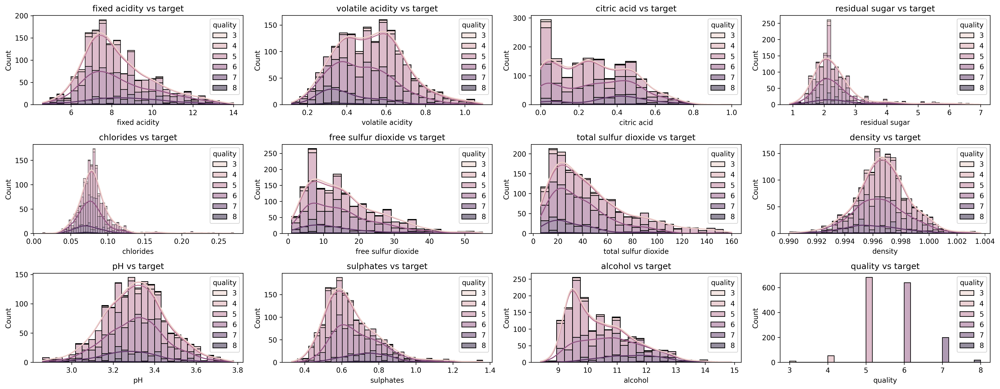

In [52]:
# subplot for all the columns
columns = wine_quality_data.columns
for i, col in enumerate(columns):
    plt.subplot(4,4, i+1)
    sns.histplot(x=col, data=wine_quality_data, hue='quality', multiple='stack', kde=True)
    plt.xlabel(col)
    plt.title("{} vs target".format(col))
    plt.tight_layout()

Label Encoding

In [53]:
# Dictionary for replacement
replace_dict = {3: 0, 4: 1, 5: 2, 6: 3, 7: 4, 8: 5}

In [54]:
# Replace values
labels = wine_quality_data['quality'].replace(replace_dict)

Splitting the Data

In [55]:
# seperating the data and labels
X = wine_quality_data.drop(columns='quality',axis=1)
y = labels

In [56]:
#importing the train_test_split to split the data
from sklearn.model_selection import train_test_split

In [57]:
# spliting the data in training & testing data
X_train , X_test , y_train , y_test = train_test_split(X,y,test_size=0.2,random_state=2,stratify=y)

In [58]:
print(X.shape , X_train.shape , X_test.shape)

(1599, 11) (1279, 11) (320, 11)


Data Standardization

In [59]:
# importing the Standard Scaler to standardize the data
from sklearn.preprocessing import StandardScaler

In [60]:
scaler = StandardScaler()

In [61]:
# saving the all columns of training data
all_columns = X_train.columns

In [62]:
# scaling the Training Data
X_train[all_columns] = scaler.fit_transform(X_train[all_columns])

In [63]:
# Test Data Preprocessed
# scaling the test data
X_test[all_columns] = scaler.transform(X_test[all_columns])

In [64]:
# first 5 rows after standardization
X_train.head()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
831,-1.437500,0.535830,-1.008455,-0.343946,-0.469240,0.028591,-0.697950,-1.592930,1.686003,0.771892,0.648150
691,0.514343,2.364152,-0.185804,0.224302,0.144104,-0.368745,1.457893,1.577188,1.150339,-0.760769,-0.577809
222,-0.905180,0.535830,-1.214117,-1.025844,-1.005916,-1.064083,-1.135368,-0.810897,0.748591,-0.360944,-0.860722
1559,-0.313712,0.476852,-0.082973,-0.457596,-0.124234,1.518601,2.645169,-0.301789,-0.657526,-0.894043,-0.483504
1067,1.638131,-1.233513,1.305251,-0.230297,-0.890914,-1.262751,-1.135368,-0.564216,-1.929727,1.171717,0.459541


In [65]:
# statistical description about scaled training data
X_train.describe()

,fixed acidity,volatile acidity,citric acid,residual sugar,chlorides,free sulfur dioxide,total sulfur dioxide,density,pH,sulphates,alcohol
count,1.279000e+03,1.279000e+03,1.279000e+03,1.279000e+03,1.279000e+03,1.279000e+03,1.279000e+03,1.279000e+03,1.279000e+03,1.279000e+03,1.279000e+03
mean,8.194297e-16,-4.833246e-16,-4.999910e-17,-1.999964e-16,1.402752e-16,4.999910e-17,-6.944319e-17,-7.294625e-14,1.747191e-15,-2.444400e-16,5.513789e-16
std,1.000391e+00,1.000391e+00,1.000391e+00,1.000391e+00,1.000391e+00,1.000391e+00,1.000391e+00,1.000391e+00,1.000391e+00,1.000391e+00,1.000391e+00
min,-2.147262e+00,-2.354097e+00,-1.419780e+00,-1.707742e+00,-2.730946e+00,-1.461419e+00,-1.260344e+00,-3.529641e+00,-3.001055e+00,-2.160155e+00,-1.898072e+00
25%,-6.981659e-01,-7.616882e-01,-9.056234e-01,-5.712456e-01,-5.075738e-01,-8.654147e-01,-7.604386e-01,-6.035801e-01,-6.575260e-01,-6.941311e-01,-8.607225e-01
50%,-1.954185e-01,5.027223e-03,-8.297259e-02,-2.302967e-01,-1.625679e-01,-1.700769e-01,-2.605328e-01,2.626322e-03,1.205357e-02,-2.276690e-01,-2.005907e-01
75%,5.734895e-01,6.537864e-01,8.425095e-01,2.243019e-01,2.591061e-01,6.245949e-01,4.893258e-01,5.799658e-01,6.146752e-01,5.053427e-01,5.538456e-01
max,3.353387e+00,3.248823e+00,3.721787e+00,5.224886e+00,7.159225e+00,3.902616e+00,3.551249e+00,3.618871e+00,3.159078e+00,4.703501e+00,4.231723e+00


# Model Selection

Comparing the models with default hyperparameter values using Cross Validation

In [66]:
# importing the standard classification models from sklearn library
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier

In [67]:
# all models in a dictionary
models = {
    'Logistic Regression': LogisticRegression(),
    'KNN': KNeighborsClassifier(),
    'Random Forest': RandomForestClassifier(),
    'SVM': SVC(kernel='linear'),
    'XGBoost': XGBClassifier()
}

In [68]:
# importing cross validation score function to calculate the cross validation score
from sklearn.model_selection import cross_val_score

In [69]:
# defining a function who can give you cross validation scores on given data with given set of model
def compare_models_cross_validation(models,X,y):
  for name, model in models.items():
    cv_score = cross_val_score(model, X, y, cv=5)
    mean_accuracy = cv_score.mean() * 100
    print(f"Model: {name}")
    print('Cross Validation accuracies for the',model,'=', cv_score)
    print('Acccuracy score of the ',model,'=',mean_accuracy,'%')
    print("="*50)

In [70]:
# calling the compare function for the models we choose
compare_models_cross_validation(models,X_train,y_train)

Model: Logistic Regression
Cross Validation accuracies for the LogisticRegression() = [0.58203125 0.58984375 0.5859375  0.6015625  0.61960784]
Acccuracy score of the  LogisticRegression() = 59.579656862745104 %
Model: KNN
Cross Validation accuracies for the KNeighborsClassifier() = [0.61328125 0.58984375 0.58203125 0.57421875 0.58431373]
Acccuracy score of the  KNeighborsClassifier() = 58.87377450980392 %
Model: Random Forest
Cross Validation accuracies for the RandomForestClassifier() = [0.7265625  0.65625    0.671875   0.65625    0.69803922]
Acccuracy score of the  RandomForestClassifier() = 68.1795343137255 %
Model: SVM
Cross Validation accuracies for the SVC(kernel='linear') = [0.56640625 0.58203125 0.58203125 0.609375   0.6       ]
Acccuracy score of the  SVC(kernel='linear') = 58.79687500000001 %
Model: XGBoost
Cross Validation accuracies for the XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
             

Top 3:

RandomForestClassifier() = 68.1795343137255 %

XGBClassifier() = 66.77328431372548 %

KNeighborsClassifier() = 58.87377450980392 %

# Feature Selection

In [71]:
#importing the RFE
from sklearn.feature_selection import RFE

In [72]:
# defining a function who will give you n best features for the given model and data
def find_best_feature(n,mdl,X,y):
    model = mdl
    rfe = RFE(model, n_features_to_select=n, verbose=0)
    rfe = rfe.fit(X, y)
    selected_col = X.columns[rfe.support_]
    cv_score = cross_val_score(model,X[selected_col],y, cv=5)
    mean_accuracy = cv_score.mean() * 100
    print("Selected columns: ", list(selected_col))
    print(n, mean_accuracy)
    print("----------------------\n")
    return list(selected_col),mean_accuracy

In [73]:
#importing the SelectKBest, f_classif
from sklearn.feature_selection import SelectKBest, f_classif

In [74]:
# defining a function who will give you n best features for the knn model and data
def find_best_feature_knn(n, mdl, X, y):
    selector = SelectKBest(f_classif, k=n)
    X_new = selector.fit_transform(X, y)
    selected_col = X.columns[selector.get_support()]
    cv_score = cross_val_score(mdl, X_new, y, cv=5)
    mean_accuracy = cv_score.mean() * 100
    print("Selected columns: ", list(selected_col))
    print(n, mean_accuracy)
    print("----------------------\n")
    return list(selected_col), mean_accuracy

# 1. Random Forest Classifier

Random Forest Classifier has the highest accuracy based on cross validation score according to its default hyperparameters

RandomForestClassifier() = 68.1795343137255 %

In [75]:
# loading the Random Forest Classifier model
rfc = RandomForestClassifier()

In [76]:
# getting the best features of RFC by calling the feature selection function
best_score_rfc = 0
best_features_rfc = None
for i in range(X_train.shape[1]):
    col , score = find_best_feature(i+1,rfc,X_train,y_train)
    if best_score_rfc < score:
        best_score_rfc = score
        best_features_rfc = col
print(best_features_rfc)
print(best_score_rfc)

Selected columns:  ['density']
1 48.39705882352941
----------------------

Selected columns:  ['total sulfur dioxide', 'density']
2 54.18719362745098
----------------------

Selected columns:  ['total sulfur dioxide', 'density', 'alcohol']
3 62.70526960784314
----------------------

Selected columns:  ['volatile acidity', 'total sulfur dioxide', 'density', 'alcohol']
4 65.05330882352942
----------------------

Selected columns:  ['volatile acidity', 'total sulfur dioxide', 'density', 'sulphates', 'alcohol']
5 67.63143382352942
----------------------

Selected columns:  ['volatile acidity', 'chlorides', 'total sulfur dioxide', 'density', 'sulphates', 'alcohol']
6 68.49234068627452
----------------------

Selected columns:  ['volatile acidity', 'chlorides', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']
7 68.49172794117648
----------------------

Selected columns:  ['volatile acidity', 'residual sugar', 'chlorides', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 

Best Features : ['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']

In [77]:
# using a diffferent df to store
X_train_best_features_rfc = X_train[best_features_rfc]

In [78]:
# getting the cross val score of rfc with its best features
cv_score_rfc = cross_val_score(rfc, X_train_best_features_rfc, y_train, cv=5)
print(cv_score_rfc)
print(cv_score_rfc.mean())

[0.7109375  0.65625    0.703125   0.6484375  0.69411765]
0.6825735294117647


In [79]:
# fitting the default model with its best features
rfc.fit(X_train_best_features_rfc,y_train)

RandomForestClassifier()

In [80]:
# taking only best features of rfc to test data
X_test_best_features_rfc = X_test[best_features_rfc]

In [81]:
best_features_rfc

['fixed acidity',
 'volatile acidity',
 'citric acid',
 'residual sugar',
 'chlorides',
 'free sulfur dioxide',
 'total sulfur dioxide',
 'density',
 'pH',
 'sulphates',
 'alcohol']

In [82]:
# predicting the labels on test data
y_predict_rfc = rfc.predict(X_test_best_features_rfc)

In [83]:
# importing the classification report for evaluation
from sklearn.metrics import classification_report

In [84]:
# the classification report for evaluation
print(classification_report(y_test, y_predict_rfc))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.00      0.00      0.00        11
           2       0.70      0.82      0.76       136
           3       0.65      0.67      0.66       128
           4       0.71      0.50      0.59        40
           5       0.00      0.00      0.00         3

    accuracy                           0.68       320
   macro avg       0.35      0.33      0.33       320
weighted avg       0.65      0.68      0.66       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [85]:
# importing the confusion matrix
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [86]:
# the confusion matrix
print(confusion_matrix(y_test, y_predict_rfc))

[[  0   0   2   0   0   0]
 [  0   0   5   6   0   0]
 [  0   0 112  23   1   0]
 [  0   0  36  86   6   0]
 [  0   0   4  15  20   1]
 [  0   0   0   2   1   0]]


In [87]:
#uniques values in ytest
y_test.value_counts()

quality
2    136
3    128
4     40
1     11
5      3
0      2
Name: count, dtype: int64

# Hyperparameter Tuning : Random Forest Classifier

In [88]:
# importing gridsearchcv to check the best hyperparameters
from sklearn.model_selection import GridSearchCV

In [89]:
#setting the hyperparameters
params_rfc = {
    'n_estimators': [100, 200,300, 400],
    'max_depth': [10, 20, 30,40],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
    }

In [ ]:
# fitting the data and model to grid search cv
grid_rfc = GridSearchCV(estimator=rfc, param_grid=params_rfc, cv=5, n_jobs=-1)
grid_rfc.fit(X_train_best_features_rfc,y_train)

In [93]:
# getting the best hyperparameters
print(grid_rfc.best_estimator_, grid_rfc.best_params_, grid_rfc.best_score_)

RandomForestClassifier(max_depth=40, min_samples_split=5, n_estimators=400) {'max_depth': 40, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 400} 0.6872579656862745


In [92]:
# testing grid_rfc model on test data
y_predict_grid_rfc = grid_rfc.predict(X_test_best_features_rfc)
print(classification_report(y_test, y_predict_grid_rfc))
print(confusion_matrix(y_test, y_predict_grid_rfc))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.00      0.00      0.00        11
           2       0.69      0.79      0.74       136
           3       0.63      0.67      0.65       128
           4       0.78      0.53      0.63        40
           5       0.00      0.00      0.00         3

    accuracy                           0.67       320
   macro avg       0.35      0.33      0.34       320
weighted avg       0.64      0.67      0.65       320

[[  0   0   2   0   0   0]
 [  0   0   5   6   0   0]
 [  0   0 108  27   1   0]
 [  0   0  38  86   4   0]
 [  0   0   4  15  21   0]
 [  0   0   0   2   1   0]]


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Best Parameters : {'max_depth': 40, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 400}

# Final Model : Random Forest Classifier

In [94]:
# loading the model with best hyper parameter
model1 = RandomForestClassifier(max_depth=40, min_samples_split=5, n_estimators=400)

In [95]:
# fitting the training data with best features of rfc
model1.fit(X_train_best_features_rfc,y_train)

RandomForestClassifier(max_depth=40, min_samples_split=5, n_estimators=400)

# Model Evaluation :Random Forest Classifier

In [96]:
# predicting the test data
y_predict_model1 = model1.predict(X_test_best_features_rfc)

In [97]:
# getting classification report
print(classification_report(y_test, y_predict_model1))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.00      0.00      0.00        11
           2       0.69      0.80      0.74       136
           3       0.64      0.68      0.66       128
           4       0.77      0.50      0.61        40
           5       0.00      0.00      0.00         3

    accuracy                           0.68       320
   macro avg       0.35      0.33      0.33       320
weighted avg       0.65      0.68      0.65       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [98]:
# loading the accuracy score for evaluation
from sklearn.metrics import accuracy_score

In [99]:
#model1 accuracy on training data
y_train_predict_model1 = model1.predict(X_train_best_features_rfc)
train_data_accuracy_model1 = accuracy_score(y_train_predict_model1, y_train)
print('Accuracy on training data: ',train_data_accuracy_model1 )

Accuracy on training data:  0.9992181391712275


In [100]:
# classification report on training data of model1
print(classification_report(y_train, y_train_predict_model1))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         8
           1       1.00      0.98      0.99        42
           2       1.00      1.00      1.00       545
           3       1.00      1.00      1.00       510
           4       1.00      1.00      1.00       159
           5       1.00      1.00      1.00        15

    accuracy                           1.00      1279
   macro avg       1.00      1.00      1.00      1279
weighted avg       1.00      1.00      1.00      1279



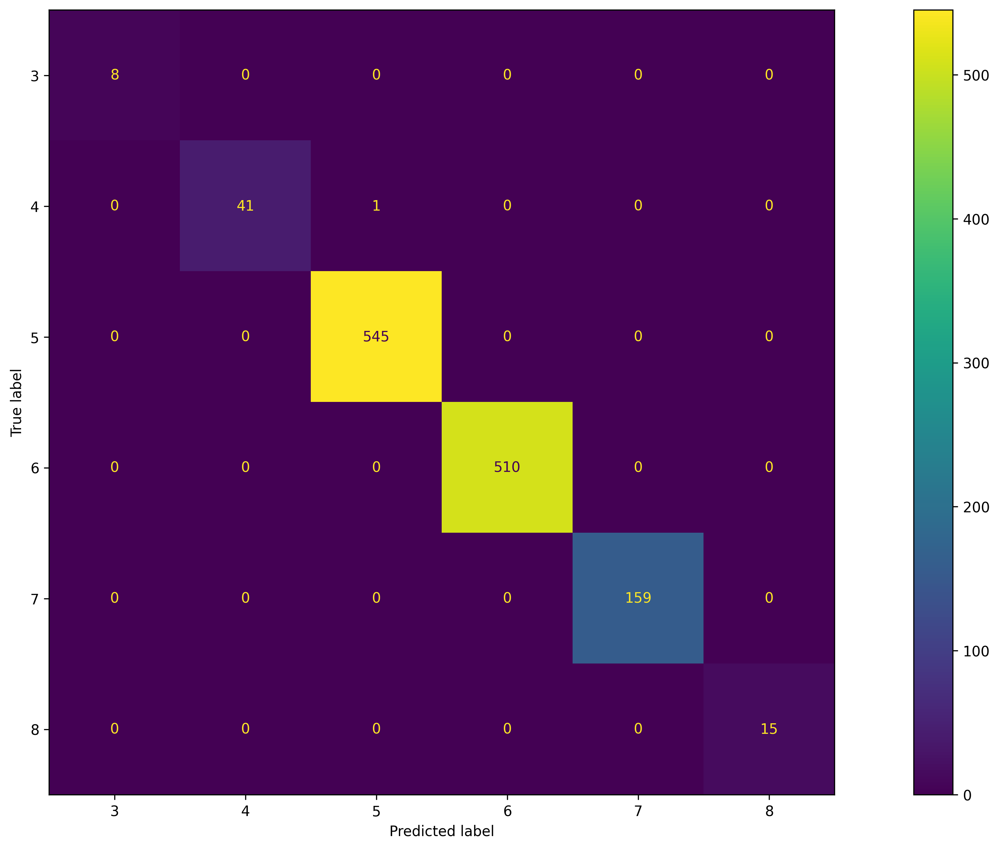

In [101]:
# confusion matrix of training data
fig, ax = plt.subplots()
cm = confusion_matrix(y_train, y_train_predict_model1)
disp = ConfusionMatrixDisplay(cm, display_labels=['3', '4','5','6','7','8'])
disp.plot(ax=ax)
plt.show()

In [102]:
#model1 accuracy on test data
y_test_predict_model1 = model1.predict(X_test_best_features_rfc)
test_data_accuracy_model1 = accuracy_score(y_test_predict_model1, y_test)
print('Accuracy on test data: ',test_data_accuracy_model1 )

Accuracy on test data:  0.675


In [103]:
#classification report on test data of model1
print(classification_report(y_test, y_test_predict_model1))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.00      0.00      0.00        11
           2       0.69      0.80      0.74       136
           3       0.64      0.68      0.66       128
           4       0.77      0.50      0.61        40
           5       0.00      0.00      0.00         3

    accuracy                           0.68       320
   macro avg       0.35      0.33      0.33       320
weighted avg       0.65      0.68      0.65       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


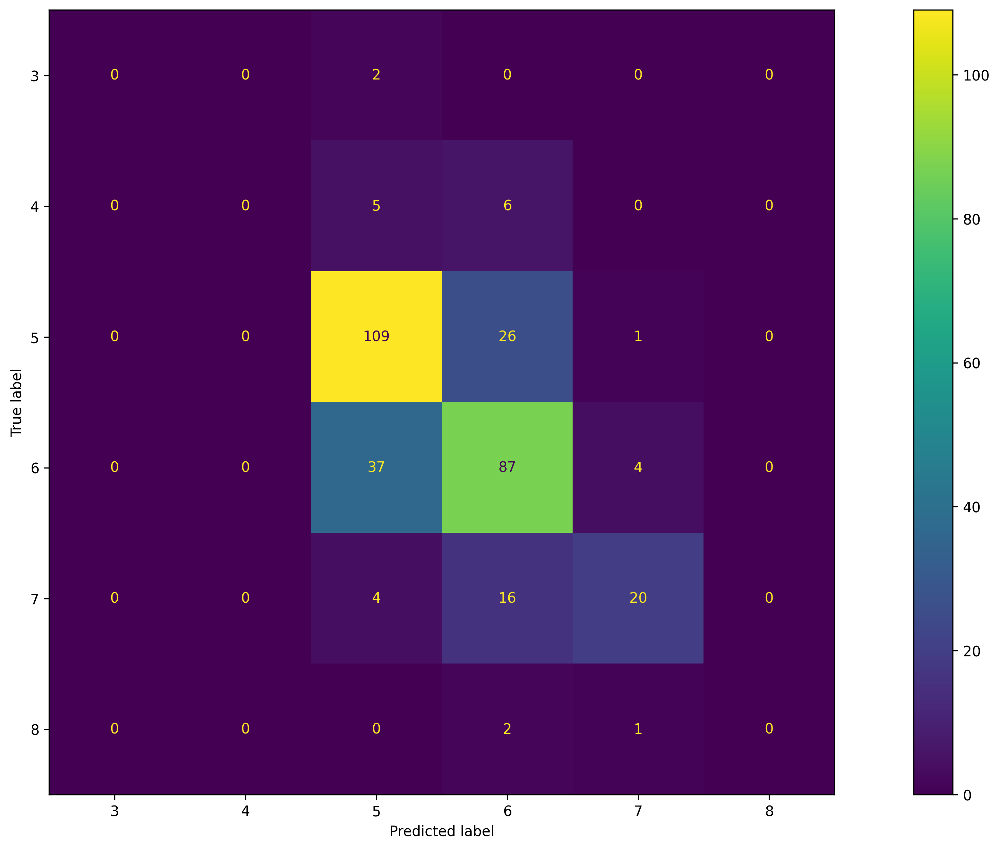

In [104]:
# confusion matrix of test data
fig, ax = plt.subplots()
cm = confusion_matrix(y_test, y_test_predict_model1)
disp = ConfusionMatrixDisplay(cm, display_labels=['3', '4','5','6','7','8'])
disp.plot(ax=ax)
plt.show()

# 2 .XG Boost Classifier

XG Boost Classifier as the 2nd highest accuracy based on cross validation score according to its default hyperparameters

XGBClassifier() =  66.77328431372548 %

In [105]:
# loading the XG Boost Classifier model
xgb = XGBClassifier()

In [106]:
# getting the best features of SVC by calling the feature selection function
best_score_xgb = 0
best_features_xgb = None
for i in range(X_train.shape[1]):
    col , score = find_best_feature(i+1,xgb,X_train,y_train)
    if best_score_xgb < score:
        best_score_xgb = score
        best_features_xgb = col
print(best_features_xgb)
print(best_score_xgb)

Selected columns:  ['alcohol']
1 55.12132352941176
----------------------

Selected columns:  ['sulphates', 'alcohol']
2 56.05851715686274
----------------------

Selected columns:  ['total sulfur dioxide', 'sulphates', 'alcohol']
3 62.47303921568628
----------------------

Selected columns:  ['volatile acidity', 'total sulfur dioxide', 'sulphates', 'alcohol']
4 64.42585784313725
----------------------

Selected columns:  ['volatile acidity', 'total sulfur dioxide', 'pH', 'sulphates', 'alcohol']
5 64.42647058823529
----------------------

Selected columns:  ['volatile acidity', 'residual sugar', 'total sulfur dioxide', 'pH', 'sulphates', 'alcohol']
6 64.27083333333333
----------------------

Selected columns:  ['volatile acidity', 'residual sugar', 'chlorides', 'total sulfur dioxide', 'pH', 'sulphates', 'alcohol']
7 66.14491421568627
----------------------

Selected columns:  ['volatile acidity', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'pH', 'sulph

Best Features : ['fixed acidity', 'volatile acidity', 'citric acid', 'residual sugar', 'chlorides', 'free sulfur dioxide', 'total sulfur dioxide', 'density', 'pH', 'sulphates', 'alcohol']

In [107]:
# using a diffferent df to store
X_train_best_features_xgb = X_train[best_features_xgb]

In [108]:
# getting the cross val score of lr with its best features
cv_score_xgb = cross_val_score(xgb, X_train_best_features_xgb, y_train, cv=5)
print(cv_score_xgb)
print(cv_score_xgb.mean())

[0.71484375 0.62109375 0.65625    0.6484375  0.69803922]
0.6677328431372549


In [109]:
# fitting the default model with its best features
xgb.fit(X_train_best_features_xgb,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

In [110]:
# taking only best features of xgb to test data
X_test_best_features_xgb = X_test[best_features_xgb]

In [111]:
best_features_xgb

['fixed acidity',
 'volatile acidity',
 'citric acid',
 'residual sugar',
 'chlorides',
 'free sulfur dioxide',
 'total sulfur dioxide',
 'density',
 'pH',
 'sulphates',
 'alcohol']

In [112]:
# predicting the labels on test data
y_predict_xgb = xgb.predict(X_test_best_features_xgb)

In [113]:
# the classification report for evaluation
print(classification_report(y_test, y_predict_xgb))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.00      0.00      0.00        11
           2       0.71      0.81      0.76       136
           3       0.64      0.68      0.66       128
           4       0.69      0.45      0.55        40
           5       0.00      0.00      0.00         3

    accuracy                           0.67       320
   macro avg       0.34      0.32      0.33       320
weighted avg       0.65      0.67      0.65       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [114]:
# the confusion matrix
print(confusion_matrix(y_test, y_predict_xgb))

[[  0   0   2   0   0   0]
 [  0   0   5   6   0   0]
 [  0   0 110  25   1   0]
 [  0   1  33  87   6   1]
 [  0   0   5  15  18   2]
 [  0   0   0   2   1   0]]


# Hyperparameter Tuning : XG Boost Classifier

In [115]:
# parameters for xgb & fitting the data and model to grid search cv
params_xgb = {
    'n_estimators': [300, 350, 400],
    'learning_rate': [0.01, 0.1, 1],
    'max_depth': [1,2,3,4,5],
    }
grid_xgb = GridSearchCV(estimator=xgb, param_grid=params_xgb, cv=5, n_jobs=-1)
grid_xgb.fit(X_train_best_features_xgb,y_train)

GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False, eval_metric=None,
                                     feature_types=None, gamma=None,
                                     grow_policy=None, importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None,...
                                     max_cat_threshold=None,
                                     max_cat_to_onehot=None,
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     objective='multi:softprob', ...),
             n_jobs=-1,
             param_grid={'learning_rate': [0.01, 0.1, 1],
                         'max_depth': [1, 2, 3, 4, 5],
                         'n_estimators': [300, 350, 400]})

In [116]:
# getting the best hyperparameters
print(grid_xgb.best_estimator_, grid_xgb.best_params_, grid_xgb.best_score_)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=300, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...) {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 300} 0.6614736519607843


In [117]:
# testing grid_svc model on test data
y_predict_grid_xgb = grid_xgb.predict(X_test_best_features_xgb)
print(classification_report(y_test, y_predict_grid_xgb))
print(confusion_matrix(y_test, y_predict_grid_xgb))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.00      0.00      0.00        11
           2       0.69      0.79      0.74       136
           3       0.64      0.67      0.65       128
           4       0.69      0.45      0.55        40
           5       0.00      0.00      0.00         3

    accuracy                           0.66       320
   macro avg       0.34      0.32      0.32       320
weighted avg       0.64      0.66      0.64       320

[[  0   0   2   0   0   0]
 [  0   0   6   5   0   0]
 [  0   0 108  26   2   0]
 [  0   0  36  86   5   1]
 [  0   0   4  16  18   2]
 [  0   0   0   2   1   0]]


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Best Parameters : {'learning_rate': 0.1, 'max_depth': 5, 'n_estimators': 300}

# Final Model : XG Boost Classifier

In [118]:
# loading the model with best hyper parameter
model2 = XGBClassifier(learning_rate= 0.1, max_depth= 5, n_estimators= 300)

In [119]:
# fitting the training data with best features of lr
model2.fit(X_train_best_features_xgb,y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=300, n_jobs=None,
              num_parallel_tree=None, objective='multi:softprob', ...)

# Model Evaluation : XG Boost Classifier

In [120]:
# predicting the test data
y_predict_model2 = model2.predict(X_test_best_features_xgb)

In [121]:
# getting classification report
print(classification_report(y_test, y_predict_model2))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.00      0.00      0.00        11
           2       0.69      0.79      0.74       136
           3       0.64      0.67      0.65       128
           4       0.69      0.45      0.55        40
           5       0.00      0.00      0.00         3

    accuracy                           0.66       320
   macro avg       0.34      0.32      0.32       320
weighted avg       0.64      0.66      0.64       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [122]:
#model2 accuracy on training data
y_train_predict_model2 = model2.predict(X_train_best_features_xgb)
train_data_accuracy_model2 = accuracy_score(y_train_predict_model2, y_train)
print('Accuracy on training data: ',train_data_accuracy_model2 )

Accuracy on training data:  1.0


In [123]:
# classification report on training data of model2
print(classification_report(y_train, y_train_predict_model2))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00         8
           1       1.00      1.00      1.00        42
           2       1.00      1.00      1.00       545
           3       1.00      1.00      1.00       510
           4       1.00      1.00      1.00       159
           5       1.00      1.00      1.00        15

    accuracy                           1.00      1279
   macro avg       1.00      1.00      1.00      1279
weighted avg       1.00      1.00      1.00      1279



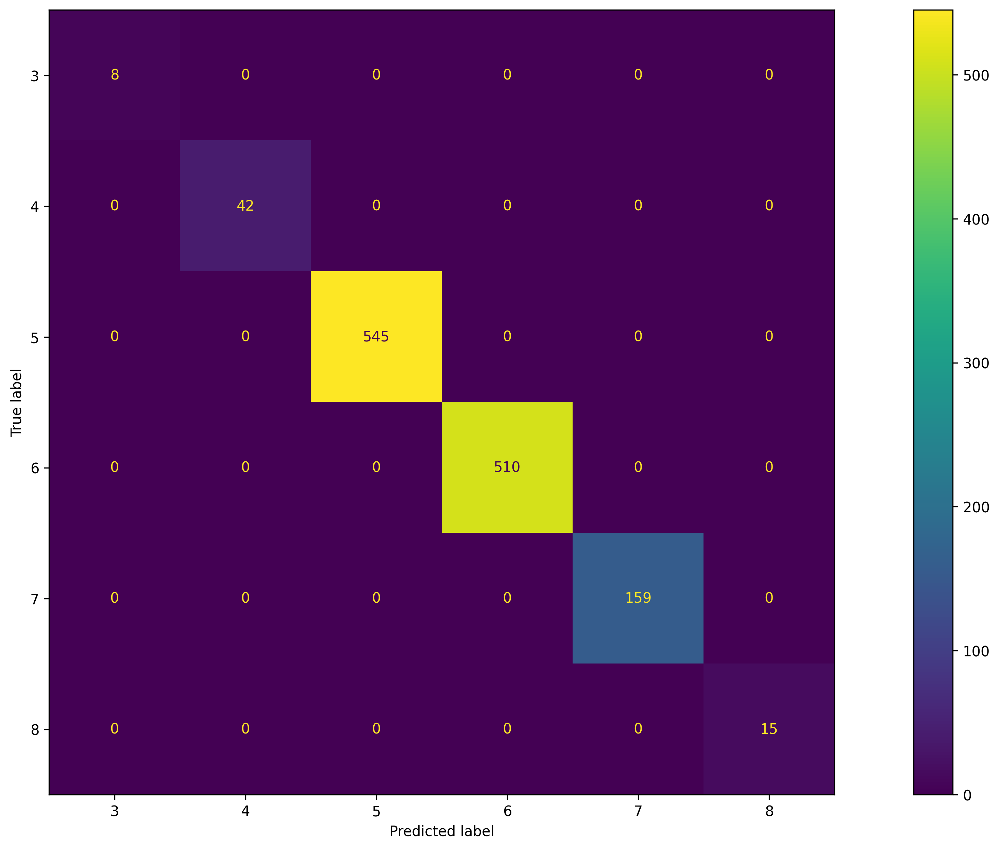

In [124]:
# confusion matrix of training data
fig, ax = plt.subplots()
cm = confusion_matrix(y_train, y_train_predict_model2)
disp = ConfusionMatrixDisplay(cm, display_labels=['3', '4','5','6','7','8'])
disp.plot(ax=ax)
plt.show()

In [125]:
#model2 accuracy on test data
y_test_predict_model2 = model2.predict(X_test_best_features_xgb)
test_data_accuracy_model2 = accuracy_score(y_test_predict_model2, y_test)
print('Accuracy on test data: ',test_data_accuracy_model2 )

Accuracy on test data:  0.6625


In [126]:
#classification report on test data of model2
print(classification_report(y_test, y_test_predict_model2))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.00      0.00      0.00        11
           2       0.69      0.79      0.74       136
           3       0.64      0.67      0.65       128
           4       0.69      0.45      0.55        40
           5       0.00      0.00      0.00         3

    accuracy                           0.66       320
   macro avg       0.34      0.32      0.32       320
weighted avg       0.64      0.66      0.64       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


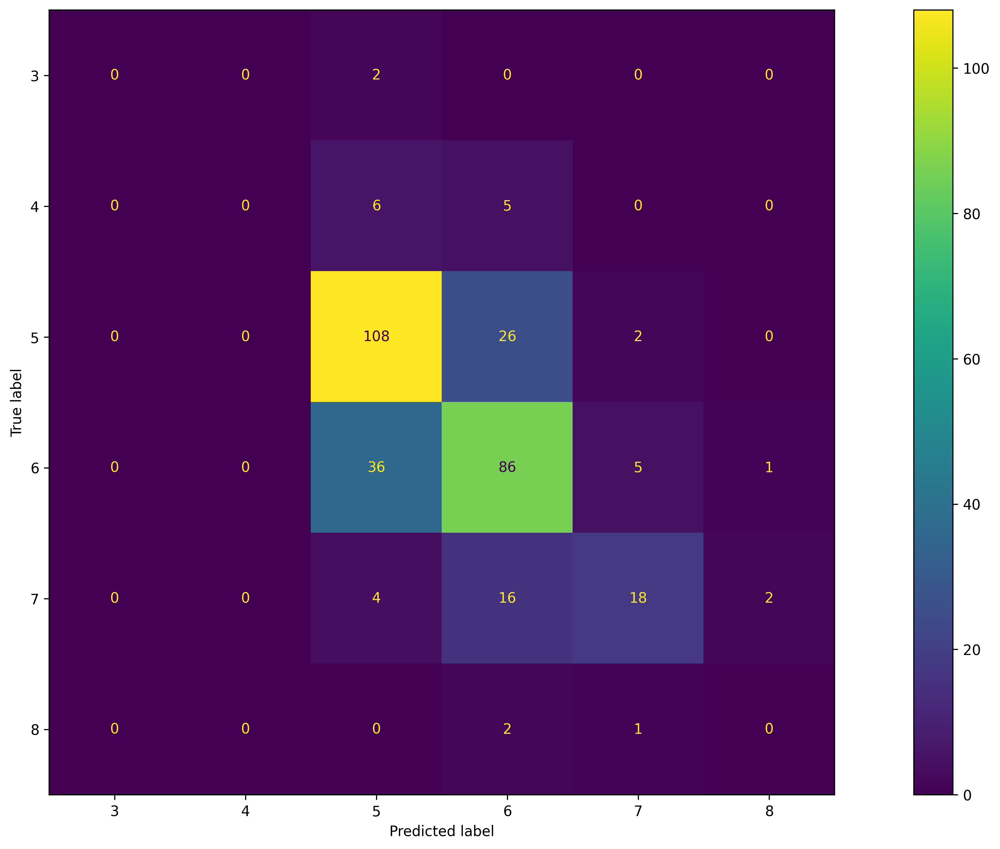

In [127]:
# confusion matrix of test data
fig, ax = plt.subplots()
cm = confusion_matrix(y_test, y_test_predict_model2)
disp = ConfusionMatrixDisplay(cm, display_labels=['3','4','5','6','7','8'])
disp.plot(ax=ax)
plt.show()

# 3. K Neighbors Classifier

K Neighbors Classifier as the 3rd highest accuracy based on cross validation score according to its default hyperparameters

KNeighborsClassifier() = 58.87377450980392 %

In [128]:
# loading the K Neighbors Classifier
knn = KNeighborsClassifier(n_neighbors=5)

In [129]:
# getting the best features of knn by calling the feature selection function
best_score_knn = 0
best_features_knn = None
for i in range(X_train.shape[1]):
    col , score = find_best_feature_knn(i+1,knn,X_train,y_train)
    if best_score_knn < score:
        best_score_knn = score
        best_features_knn = col
print(best_features_knn)
print(best_score_knn)

Selected columns:  ['alcohol']
1 49.33057598039216
----------------------

Selected columns:  ['volatile acidity', 'alcohol']
2 55.98100490196079
----------------------

Selected columns:  ['volatile acidity', 'sulphates', 'alcohol']
3 55.43504901960784
----------------------

Selected columns:  ['volatile acidity', 'total sulfur dioxide', 'sulphates', 'alcohol']
4 59.42555147058823
----------------------

Selected columns:  ['volatile acidity', 'citric acid', 'total sulfur dioxide', 'sulphates', 'alcohol']
5 59.58026960784314
----------------------

Selected columns:  ['volatile acidity', 'citric acid', 'total sulfur dioxide', 'density', 'sulphates', 'alcohol']
6 60.360600490196084
----------------------

Selected columns:  ['volatile acidity', 'citric acid', 'chlorides', 'total sulfur dioxide', 'density', 'sulphates', 'alcohol']
7 60.98314950980392
----------------------

Selected columns:  ['fixed acidity', 'volatile acidity', 'citric acid', 'chlorides', 'total sulfur dioxide', 'den

Best Features : ['volatile acidity', 'citric acid', 'chlorides', 'total sulfur dioxide', 'density', 'sulphates', 'alcohol']

In [130]:
# using a diffferent df to store
X_train_best_features_knn = X_train[best_features_knn]

In [131]:
# getting the cross val score of knn with its best features
cv_score_knn = cross_val_score(knn, X_train_best_features_knn, y_train, cv=5)
print(cv_score_knn)
print(cv_score_knn.mean())

[0.6484375  0.609375   0.59375    0.61328125 0.58431373]
0.6098314950980392


In [132]:
# fitting the default model with its best features
knn.fit(X_train_best_features_knn,y_train)

KNeighborsClassifier()

In [133]:
# taking only best features of rfc to test data
X_test_best_features_knn = X_test[best_features_knn]

In [134]:
best_features_knn

['volatile acidity',
 'citric acid',
 'chlorides',
 'total sulfur dioxide',
 'density',
 'sulphates',
 'alcohol']

In [135]:
# predicting the labels on test data
y_predict_knn = knn.predict(X_test_best_features_knn)

In [136]:
# the classification report for evaluation
print(classification_report(y_test, y_predict_knn))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.50      0.09      0.15        11
           2       0.62      0.69      0.66       136
           3       0.53      0.57      0.55       128
           4       0.66      0.47      0.55        40
           5       0.00      0.00      0.00         3

    accuracy                           0.58       320
   macro avg       0.38      0.30      0.32       320
weighted avg       0.58      0.58      0.57       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [137]:
# the confusion matrix
print(confusion_matrix(y_test, y_predict_knn))

[[ 0  0  1  1  0  0]
 [ 0  1  3  6  1  0]
 [ 0  1 94 40  1  0]
 [ 0  0 49 73  6  0]
 [ 0  0  4 17 19  0]
 [ 0  0  0  1  2  0]]


# Hyperparameter Tuning : K Neighbors Classifier

In [138]:
# parameters for K Neighbors Classifier & fitting the data and model to grid search cv
params_knn = {
    'n_neighbors': np.arange(3,50),
    'metric': ['minkowski', 'euclidean'],
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
    }
grid_knn = GridSearchCV(estimator=knn, param_grid=params_knn, cv=5, n_jobs=-1)
grid_knn.fit(X_train_best_features_knn,y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'metric': ['minkowski', 'euclidean'],
                         'n_neighbors': array([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19,
       20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36,
       37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49])})

In [139]:
# getting the best hyperparameters
print(grid_knn.best_estimator_, grid_knn.best_params_, grid_knn.best_score_)

KNeighborsClassifier() {'algorithm': 'auto', 'metric': 'minkowski', 'n_neighbors': 5} 0.6098314950980392


In [140]:
# testing grid_knn model on test data
y_predict_grid_knn = grid_knn.predict(X_test_best_features_knn)
print(classification_report(y_test, y_predict_grid_knn))
print(confusion_matrix(y_test, y_predict_grid_knn))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.50      0.09      0.15        11
           2       0.62      0.69      0.66       136
           3       0.53      0.57      0.55       128
           4       0.66      0.47      0.55        40
           5       0.00      0.00      0.00         3

    accuracy                           0.58       320
   macro avg       0.38      0.30      0.32       320
weighted avg       0.58      0.58      0.57       320

[[ 0  0  1  1  0  0]
 [ 0  1  3  6  1  0]
 [ 0  1 94 40  1  0]
 [ 0  0 49 73  6  0]
 [ 0  0  4 17 19  0]
 [ 0  0  0  1  2  0]]


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Best Parameters : {'algorithm': 'auto', 'metric': 'minkowski', 'n_neighbors': 5}

# Final Model : K Neighbors Classifier

In [141]:
# loading the model with best hyper parameter
model3 = KNeighborsClassifier()

In [142]:
# fitting the training data with best features of rfc
model3.fit(X_train_best_features_knn,y_train)

KNeighborsClassifier()

# Model Evaluation : K Neighbors Classifier

In [143]:
# predicting the test data
y_predict_model3 = model3.predict(X_test_best_features_knn)

In [144]:
# getting classification report
print(classification_report(y_test, y_predict_model3))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.50      0.09      0.15        11
           2       0.62      0.69      0.66       136
           3       0.53      0.57      0.55       128
           4       0.66      0.47      0.55        40
           5       0.00      0.00      0.00         3

    accuracy                           0.58       320
   macro avg       0.38      0.30      0.32       320
weighted avg       0.58      0.58      0.57       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [145]:
#model3 accuracy on training data
y_train_predict_model3 = model3.predict(X_train_best_features_knn)
train_data_accuracy_model3 = accuracy_score(y_train_predict_model3, y_train)
print('Accuracy on training data: ',train_data_accuracy_model3 )

Accuracy on training data:  0.7224394057857702


In [146]:
# classification report on training data of model3
print(classification_report(y_train, y_train_predict_model3))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         8
           1       0.33      0.07      0.12        42
           2       0.76      0.84      0.80       545
           3       0.69      0.75      0.72       510
           4       0.72      0.51      0.60       159
           5       0.00      0.00      0.00        15

    accuracy                           0.72      1279
   macro avg       0.42      0.36      0.37      1279
weighted avg       0.70      0.72      0.70      1279



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


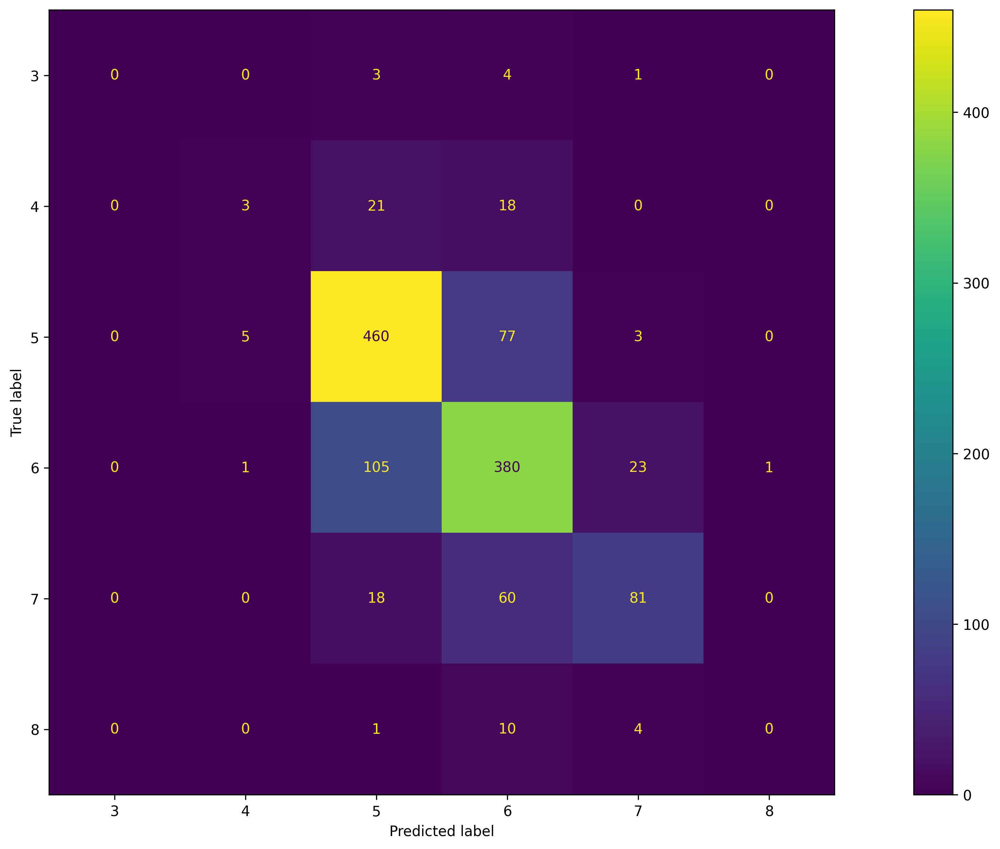

In [147]:
# confusion matrix of training data
fig, ax = plt.subplots()
cm = confusion_matrix(y_train, y_train_predict_model3)
disp = ConfusionMatrixDisplay(cm, display_labels=['3','4','5','6','7','8'])
disp.plot(ax=ax)
plt.show()


In [148]:
#model3 accuracy on test data
y_test_predict_model3 = model3.predict(X_test_best_features_knn)
test_data_accuracy_model3 = accuracy_score(y_test_predict_model3, y_test)
print('Accuracy on test data: ',test_data_accuracy_model3 )

Accuracy on test data:  0.584375


In [149]:
#classification report on test data of model3
print(classification_report(y_test, y_test_predict_model3))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         2
           1       0.50      0.09      0.15        11
           2       0.62      0.69      0.66       136
           3       0.53      0.57      0.55       128
           4       0.66      0.47      0.55        40
           5       0.00      0.00      0.00         3

    accuracy                           0.58       320
   macro avg       0.38      0.30      0.32       320
weighted avg       0.58      0.58      0.57       320



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1517: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


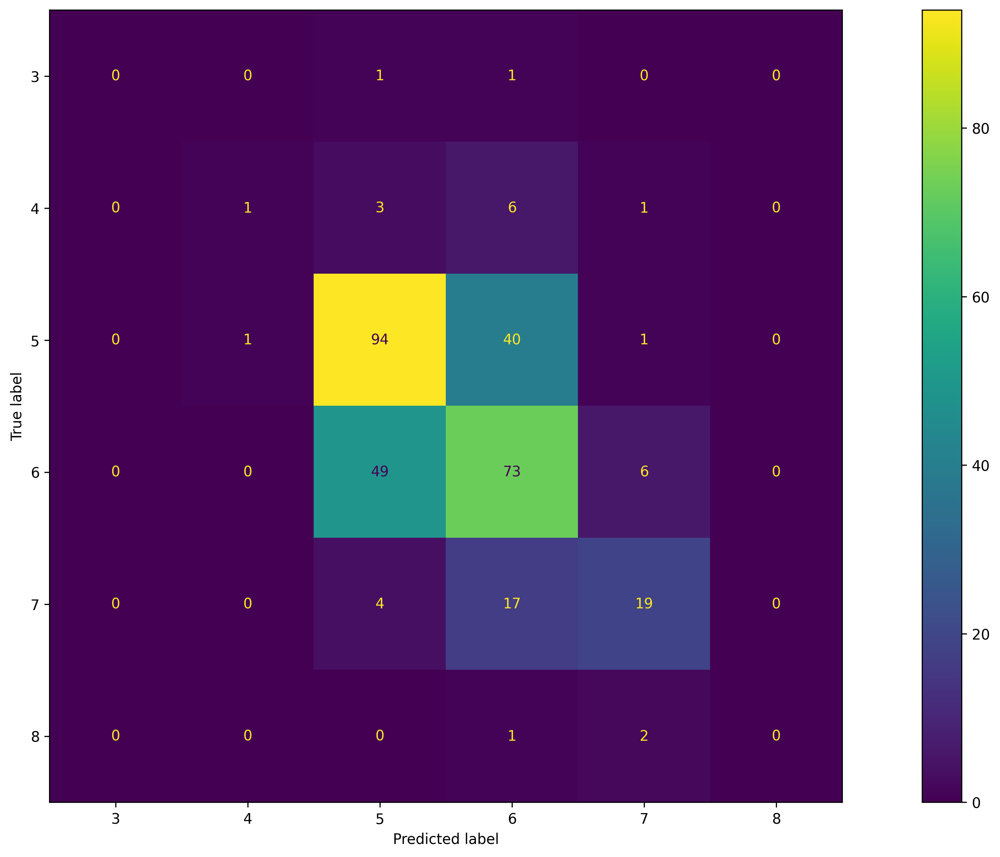

In [150]:
# confusion matrix of test data
fig, ax = plt.subplots()
cm = confusion_matrix(y_test, y_test_predict_model3)
disp = ConfusionMatrixDisplay(cm, display_labels=['3', '4','5','6','7','8'])
disp.plot(ax=ax)
plt.show()

# Conclusion

Model 1 : Logistic Regression Model

Training Data Accuracy : 99.921%

Testing Data Accuracy : 67.5%

Model 2 :XG Boost Classifier

Training Data Accuracy : 100%

Testing Data Accuracy : 66.25%

Model 3 : K Neighbors Classifier

Training Data Accuracy : 72.243%

Testing Data Accuracy : 58.437%

# Predictive System

Buliding a Predictive System for here

In [151]:
#taking input data
input_data = (8.8,0.24,0.54,2.5,0.083,25.0,57.0,0.9983,3.39,0.54,9.2)

#loading columns
columns = all_columns

# Convert the tuple to a DataFrame
df = pd.DataFrame([input_data], columns=columns)

#standardizing the data
df[columns] = scaler.transform(df[columns])

#loading best features
df_best_features_rfc = df[best_features_rfc]
df_best_features_xgb = df[best_features_xgb]
df_best_features_knn = df[best_features_knn]

#predictions
prediction1 = model1.predict(df_best_features_rfc)
prediction2 = model2.predict(df_best_features_xgb)
prediction3 = model3.predict(df_best_features_knn)

# due to label encoding +3 is done
print(prediction1+3)

print(prediction2+3)

print(prediction3+3)


[5]
[5]
[5]


Building the Predictive System to export

In [152]:
import json
import pickle
with open('columns.pkl', 'wb') as file:
    pickle.dump(all_columns, file)
with open('scaler.pkl', 'wb') as f:
    pickle.dump(scaler, f)
with open('best_features_rfc.json', 'w') as file:
    json.dump(best_features_rfc, file)
with open('best_features_xgb.json', 'w') as file:
    json.dump(best_features_xgb, file)
with open('best_features_knn.json', 'w') as file:
    json.dump(best_features_knn, file)
with open('wine_quality_trained_rfc_model.sav', 'wb') as f:
    pickle.dump(model1, f)
with open('wine_quality_trained_xgb_model.sav', 'wb') as f:
    pickle.dump(model2, f)
with open('wine_quality_trained_knn_model.sav', 'wb') as f:
    pickle.dump(model3, f)

In [153]:
#loading. the saved model
with open('columns.pkl', 'rb') as f:
    all_features = pickle.load(f)
with open('scaler.pkl', 'rb') as f:
    scalers = pickle.load(f)
with open('best_features_rfc.json', 'r') as file:
    best_features_rfc = json.load(file)
with open('best_features_xgb.json', 'r') as file:
    best_features_xgb = json.load(file)
with open('best_features_knn.json', 'r') as file:
    best_features_knn = json.load(file)
with open('wine_quality_trained_rfc_model.sav', 'rb') as f:
    loaded_model_rfc = pickle.load(f)
with open('wine_quality_trained_xgb_model.sav', 'rb') as f:
    loaded_model_xgb = pickle.load(f)
with open('wine_quality_trained_knn_model.sav', 'rb') as f:
    loaded_model_knn = pickle.load(f)

In [154]:
#taking input data
input_data = (6.7,0.42,0.27,8.6,0.068,24.0,148.0,0.9948,3.16,0.57,11.3)

# Convert the tuple to a DataFrame
df = pd.DataFrame([input_data], columns=all_features)

#loading columns
df[all_features] = scalers.transform(df[all_features])

#loading best features
df_best_features_rfc = df[best_features_rfc]
df_best_features_xgb = df[best_features_xgb]
df_best_features_knn = df[best_features_knn]

#predictions
prediction1 = loaded_model_rfc.predict(df_best_features_rfc)
prediction2 = loaded_model_xgb.predict(df_best_features_xgb)
prediction3 = loaded_model_knn.predict(df_best_features_knn)

print(prediction1+3)

print(prediction2+3)

print(prediction3+3)


[6]
[6]
[6]
